In [38]:
import plotly.express as px
import pandas as pd
import numpy as np
from urllib.request import urlopen
import json

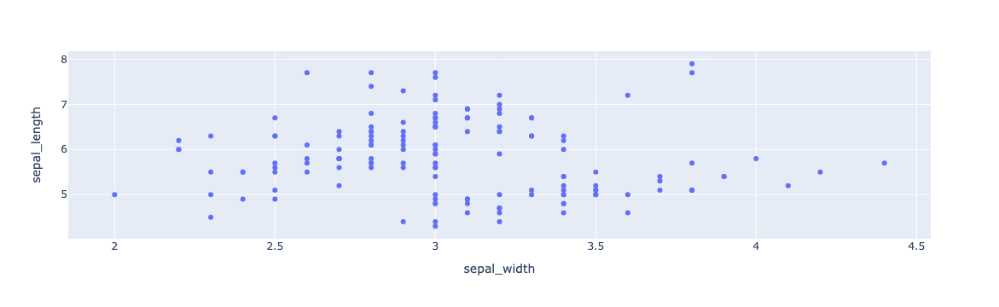

In [51]:
# scatter

df = px.data.iris() # iris is a pandas DataFrame
fig = px.scatter(df, x="sepal_width", y="sepal_length")
fig.show()

In [53]:
# scatter_3d

df = px.data.iris()
fig = px.scatter_3d(df, x='sepal_length', y='sepal_width', z='petal_width',
              color='petal_length', size='petal_length', size_max=18,
              symbol='species', opacity=0.7)

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

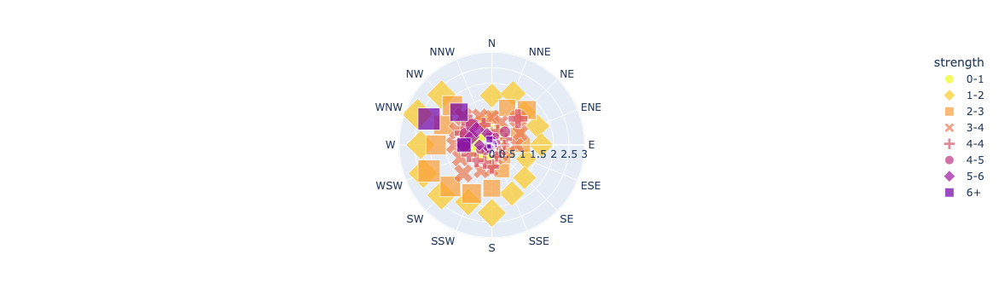

In [15]:
# scatter_polar

df = px.data.wind()
fig = px.scatter_polar(df, r="frequency", theta="direction",
                       color="strength", symbol="strength", size="frequency",
                       color_discrete_sequence=px.colors.sequential.Plasma_r)
fig.show()

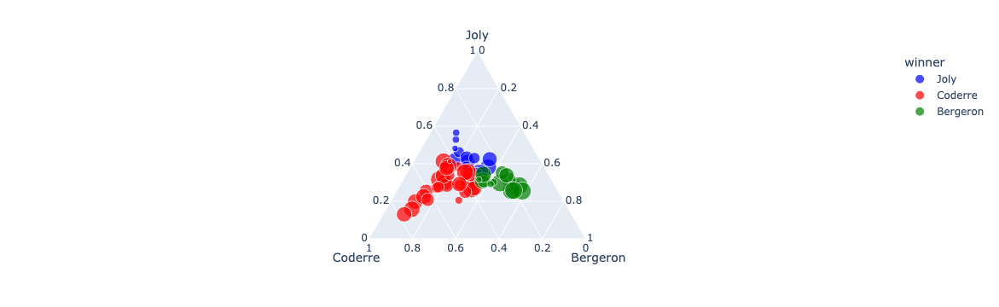

In [6]:
# scatter_ternary

df = px.data.election()
fig = px.scatter_ternary(df, a="Joly", b="Coderre", c="Bergeron", hover_name="district",
    color="winner", size="total", size_max=15,
    color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"} )
fig.show()

# scatter_mapbox

import geopandas as gpd

geo_df = gpd.read_file(gpd.datasets.get_path('naturalearth_cities'))

px.set_mapbox_access_token(open(".mapbox_token").read())
fig = px.scatter_mapbox(geo_df,
                        lat=geo_df.geometry.y,
                        lon=geo_df.geometry.x,
                        hover_name="name",
                        zoom=1)
fig.show()

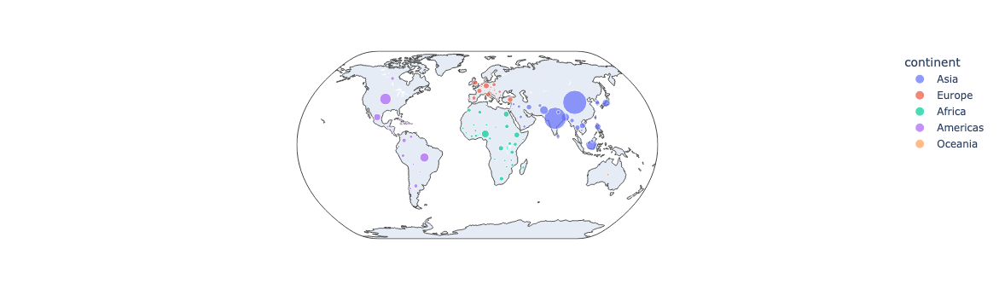

In [10]:
# scatter_geo

df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations="iso_alpha",
                     color="continent", # which column to use to set the color of markers
                     hover_name="country", # column added to hover information
                     size="pop", # size of markers
                     projection="natural earth")
fig.show()

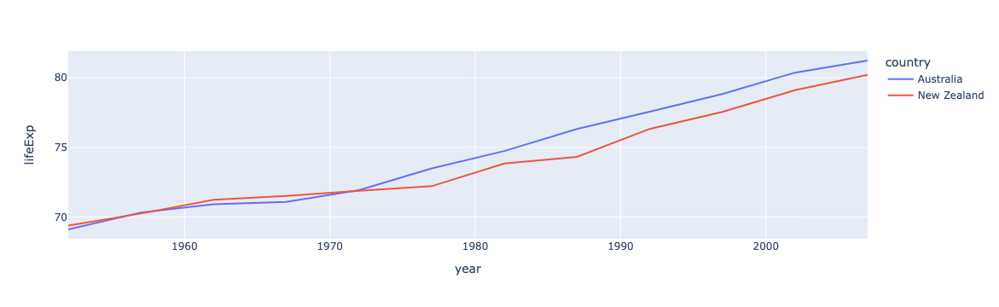

In [11]:
# line

df = px.data.gapminder().query("continent=='Oceania'")
fig = px.line(df, x="year", y="lifeExp", color='country')
fig.show()

In [12]:
# line 3d

df = px.data.gapminder().query("country=='Brazil'")
fig = px.line_3d(df, x="gdpPercap", y="pop", z="year")
fig.show()

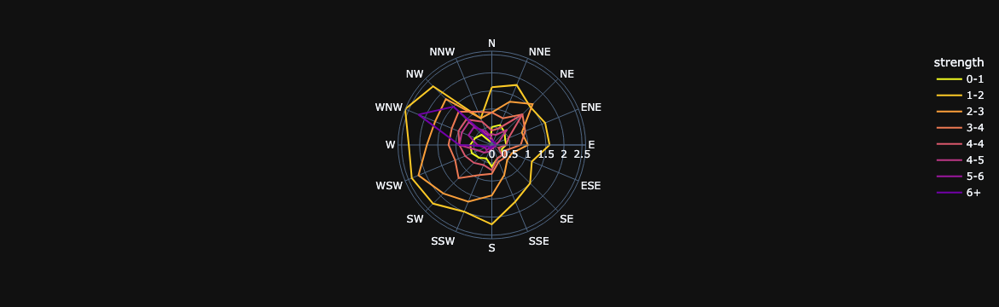

In [14]:
# line polar

df = px.data.wind()
fig = px.line_polar(df, r="frequency", theta="direction", color="strength", line_close=True,
                    color_discrete_sequence=px.colors.sequential.Plasma_r,
                    template="plotly_dark",)
fig.show()

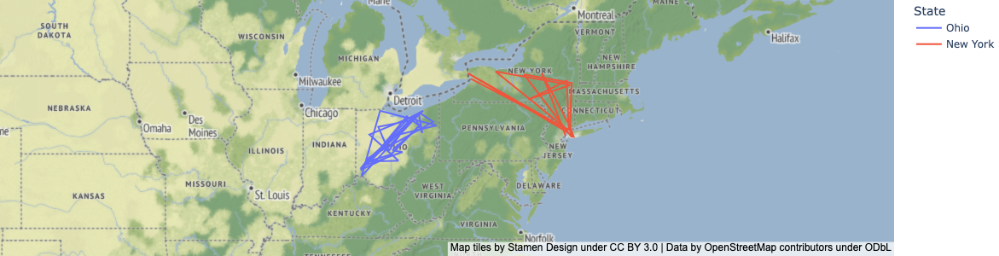

In [18]:
# line mapbox

us_cities = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/us-cities-top-1k.csv")
us_cities = us_cities.query("State in ['New York', 'Ohio']")

fig = px.line_mapbox(us_cities, lat="lat", lon="lon", color="State", zoom=3, height=300)

fig.update_layout(mapbox_style="stamen-terrain", mapbox_zoom=4, mapbox_center_lat = 41,
    margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

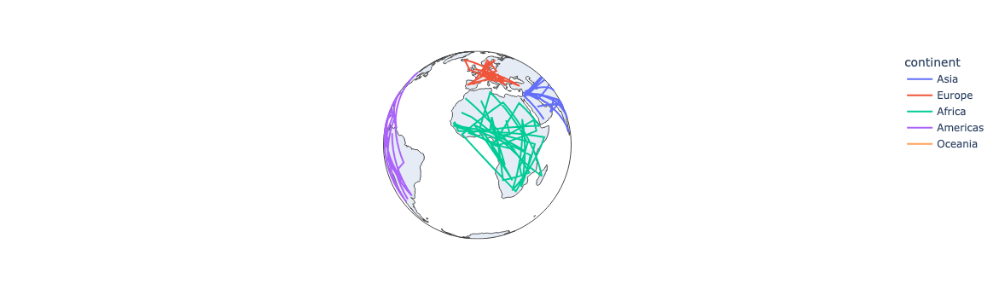

In [19]:
# line geo

df = px.data.gapminder().query("year == 2007")
fig = px.line_geo(df, locations="iso_alpha",
                  color="continent", # "continent" is one of the columns of gapminder
                  projection="orthographic")
fig.show()

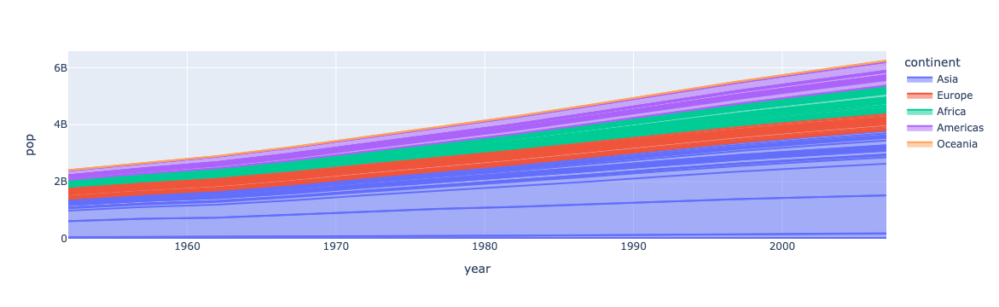

In [20]:
# area

df = px.data.gapminder()
fig = px.area(df, x="year", y="pop", color="continent", line_group="country")
fig.show()

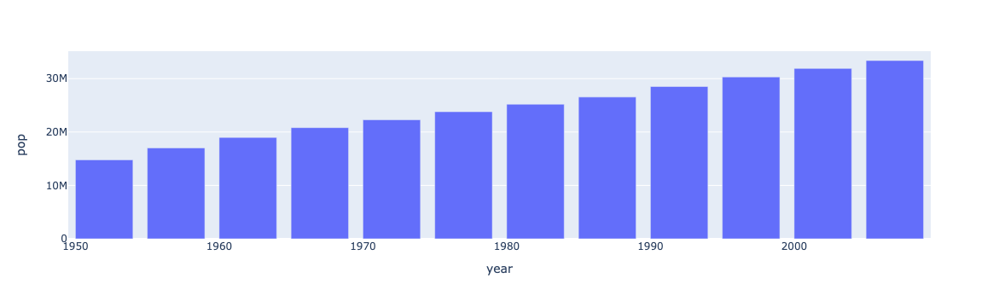

In [21]:
# bar

data_canada = px.data.gapminder().query("country == 'Canada'")
fig = px.bar(data_canada, x='year', y='pop')
fig.show()

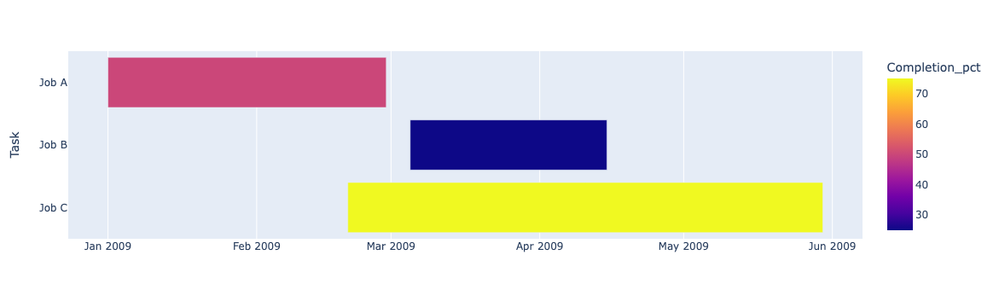

In [22]:
# timeline

df = pd.DataFrame([
    dict(Task="Job A", Start='2009-01-01', Finish='2009-02-28', Completion_pct=50),
    dict(Task="Job B", Start='2009-03-05', Finish='2009-04-15', Completion_pct=25),
    dict(Task="Job C", Start='2009-02-20', Finish='2009-05-30', Completion_pct=75)
])

fig = px.timeline(df, x_start="Start", x_end="Finish", y="Task", color="Completion_pct")
fig.update_yaxes(autorange="reversed")
fig.show()

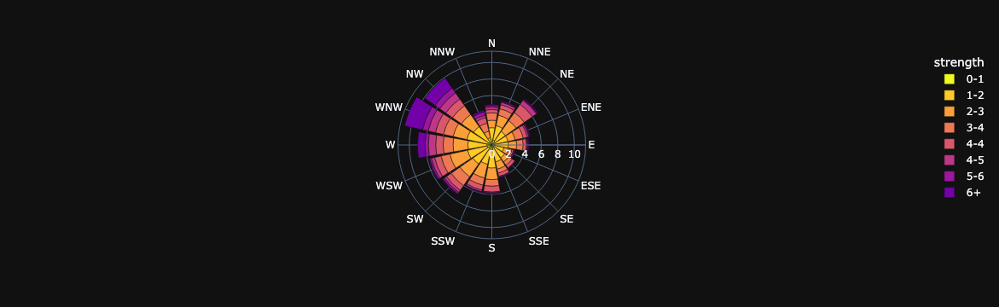

In [23]:
# bar polar

df = px.data.wind()
fig = px.bar_polar(df, r="frequency", theta="direction",
                   color="strength", template="plotly_dark",
                   color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()

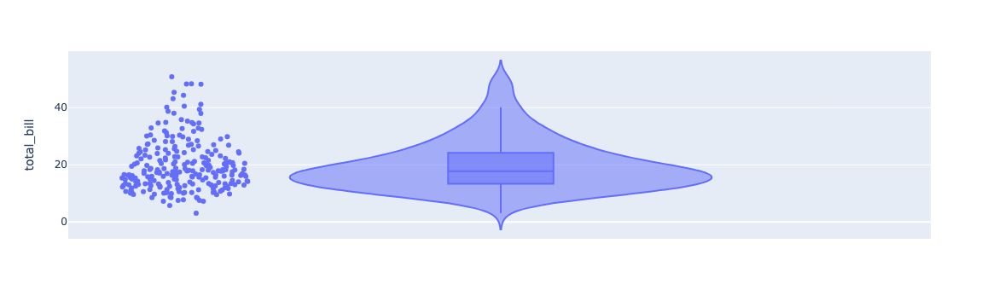

In [24]:
# violin

df = px.data.tips()
fig = px.violin(df, y="total_bill", box=True, # draw box plot inside the violin
                points='all', # can be 'outliers', or False
               )
fig.show()

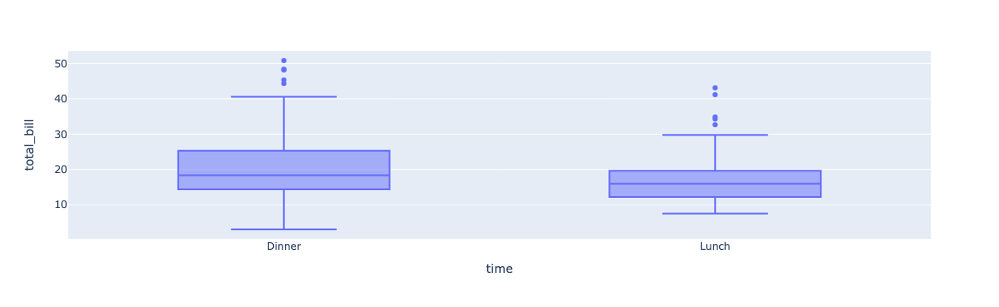

In [25]:
# box

df = px.data.tips()
fig = px.box(df, x="time", y="total_bill")
fig.show()

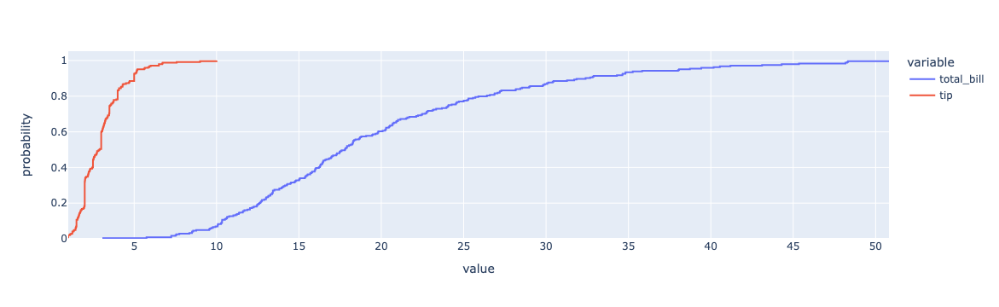

In [26]:
# ecdf

df = px.data.tips()
fig = px.ecdf(df, x=["total_bill", "tip"])
fig.show()

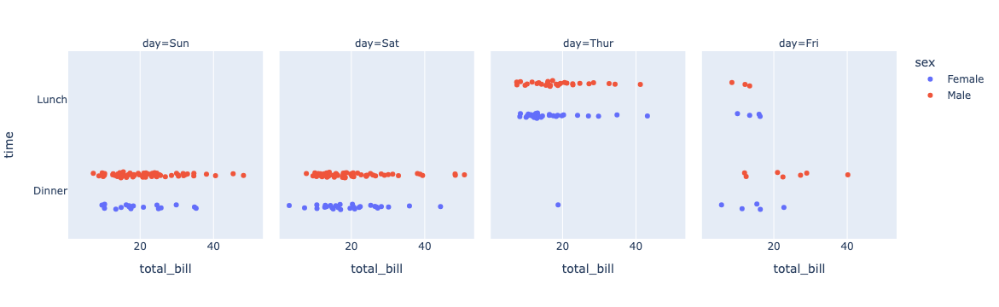

In [27]:
# strip

df = px.data.tips()
fig = px.strip(df, x="total_bill", y="time", color="sex", facet_col="day")
fig.show()

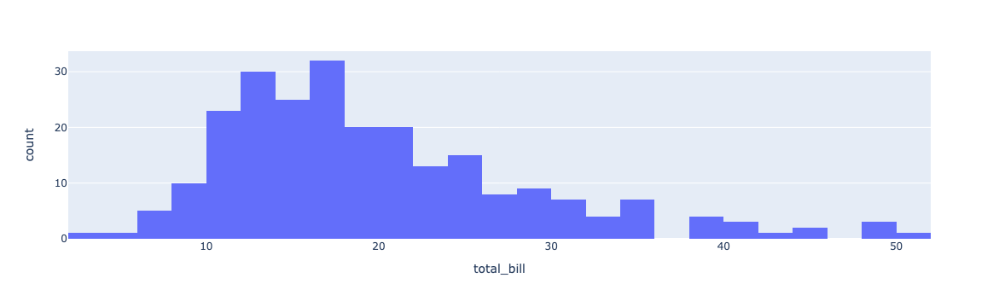

In [28]:
# histogram

df = px.data.tips()
fig = px.histogram(df, x="total_bill")
fig.show()

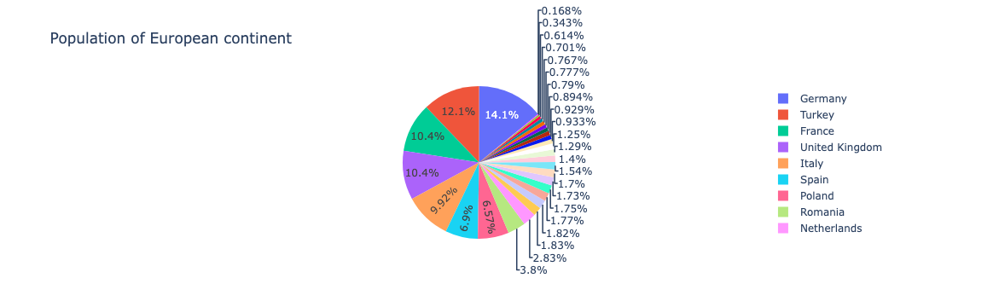

In [29]:
# pie

df = px.data.gapminder().query("year == 2007").query("continent == 'Europe'")
df.loc[df['pop'] < 2.e6, 'country'] = 'Other countries' # Represent only large countries
fig = px.pie(df, values='pop', names='country', title='Population of European continent')
fig.show()

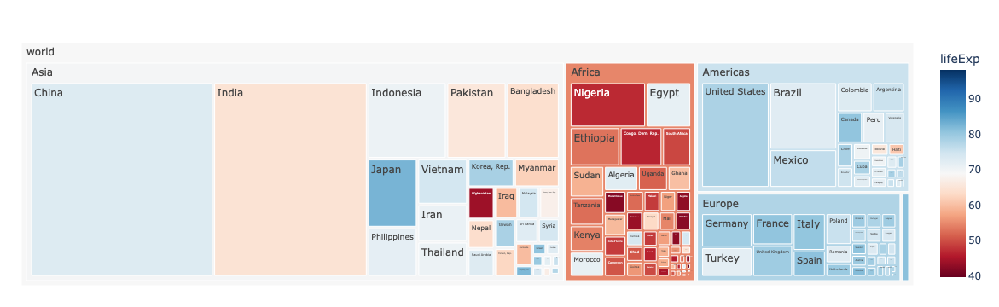

In [31]:
# treemap

df = px.data.gapminder().query("year == 2007")
fig = px.treemap(df, path=[px.Constant("world"), 'continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=np.average(df['lifeExp'], weights=df['pop']))
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

  vendors  sectors regions  sales
0       A     Tech   North      1
1       B     Tech   North      3
2       C  Finance   North      2
3       D  Finance   North      4
4    None    Other   North      1
5       E     Tech   South      2
6       F     Tech   South      2
7       G  Finance   South      1
8       H  Finance   South      4
9    None    Other   South      1


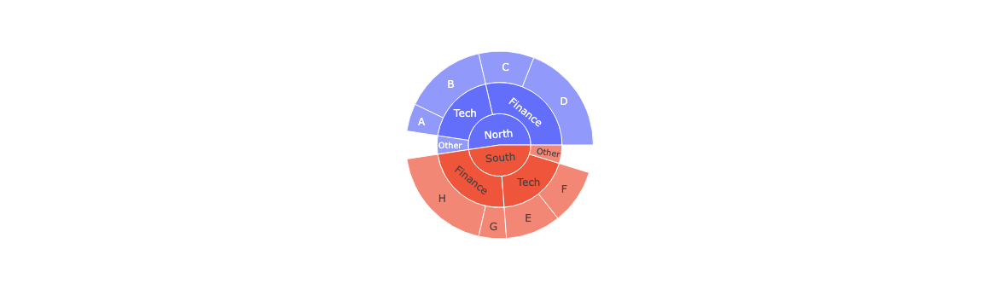

In [32]:
# sunburst

vendors = ["A", "B", "C", "D", None, "E", "F", "G", "H", None]
sectors = ["Tech", "Tech", "Finance", "Finance", "Other",
           "Tech", "Tech", "Finance", "Finance", "Other"]
regions = ["North", "North", "North", "North", "North",
           "South", "South", "South", "South", "South"]
sales = [1, 3, 2, 4, 1, 2, 2, 1, 4, 1]
df = pd.DataFrame(
    dict(vendors=vendors, sectors=sectors, regions=regions, sales=sales)
)
print(df)
fig = px.sunburst(df, path=['regions', 'sectors', 'vendors'], values='sales')
fig.show()

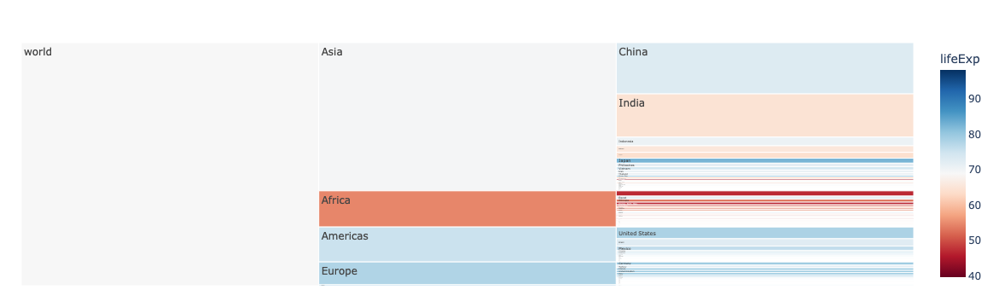

In [33]:
# icycle

df = px.data.gapminder().query("year == 2007")
fig = px.icicle(df, path=[px.Constant("world"), 'continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=np.average(df['lifeExp'], weights=df['pop']))
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

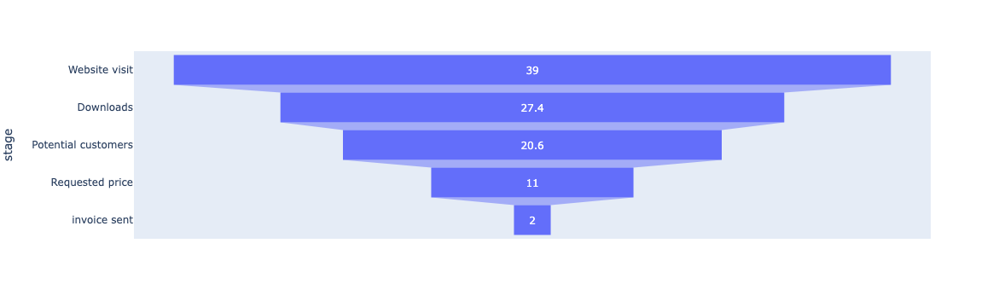

In [34]:
# funnel

data = dict(
    number=[39, 27.4, 20.6, 11, 2],
    stage=["Website visit", "Downloads", "Potential customers", "Requested price", "invoice sent"])
fig = px.funnel(data, x='number', y='stage')
fig.show()

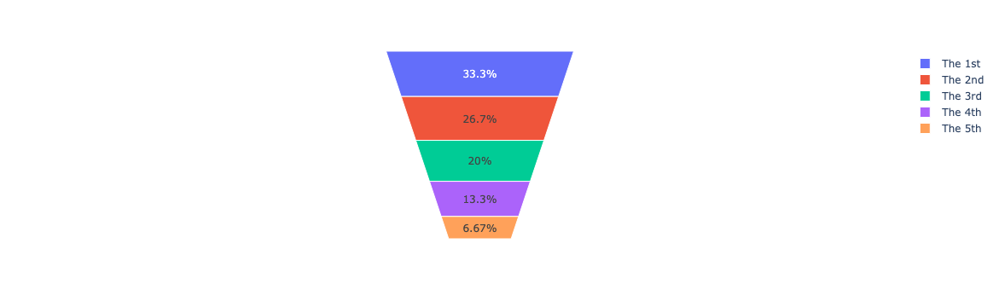

In [35]:
# funnel area

fig = px.funnel_area(names=["The 1st","The 2nd", "The 3rd", "The 4th", "The 5th"],
                    values=[5, 4, 3, 2, 1])
fig.show()

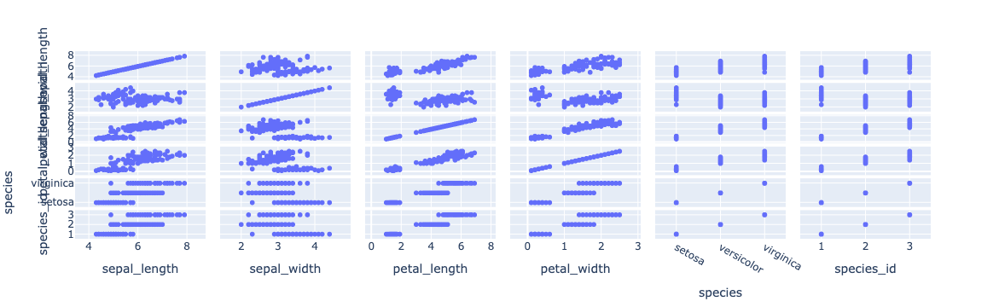

In [36]:
# scatter matrix

df = px.data.iris()
fig = px.scatter_matrix(df)
fig.show()

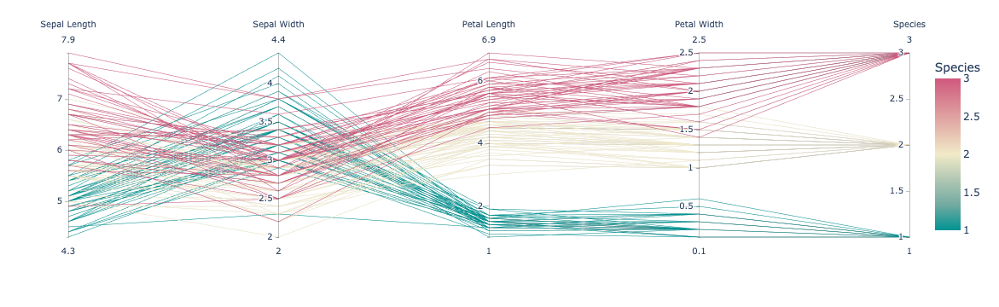

In [37]:
# parallel coordinates

df = px.data.iris()
fig = px.parallel_coordinates(df, color="species_id", labels={"species_id": "Species",
                "sepal_width": "Sepal Width", "sepal_length": "Sepal Length",
                "petal_width": "Petal Width", "petal_length": "Petal Length", },
                             color_continuous_scale=px.colors.diverging.Tealrose,
                             color_continuous_midpoint=2)
fig.show()

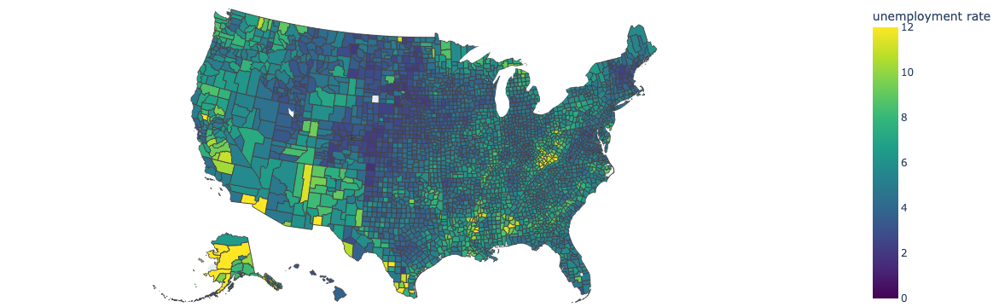

In [39]:
# choropleth

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]

df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})
df.head()

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

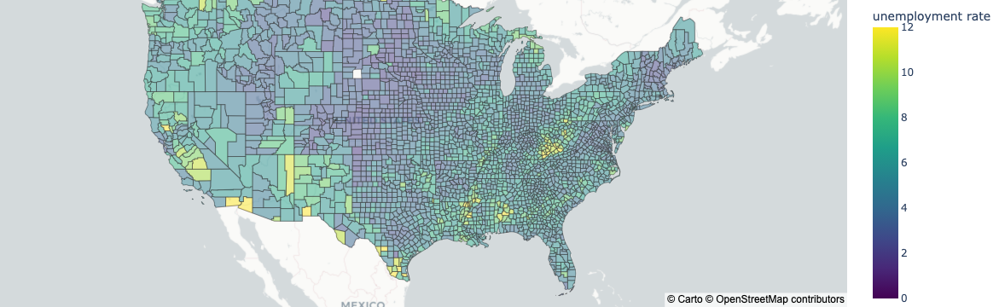

In [42]:
# choroplet mapbox

fig = px.choropleth_mapbox(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

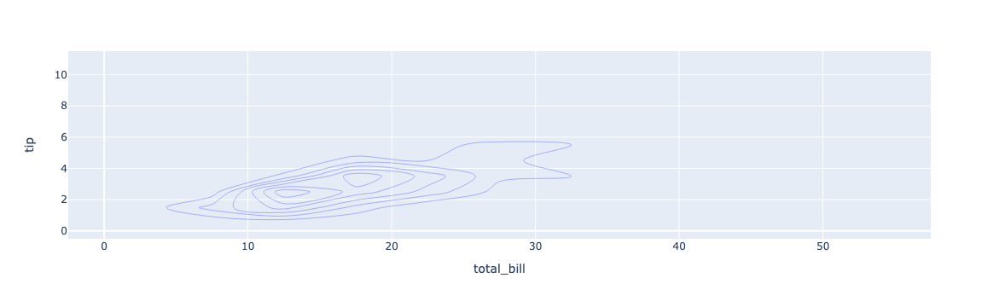

In [43]:
# density contour

df = px.data.tips()

fig = px.density_contour(df, x="total_bill", y="tip")
fig.show()

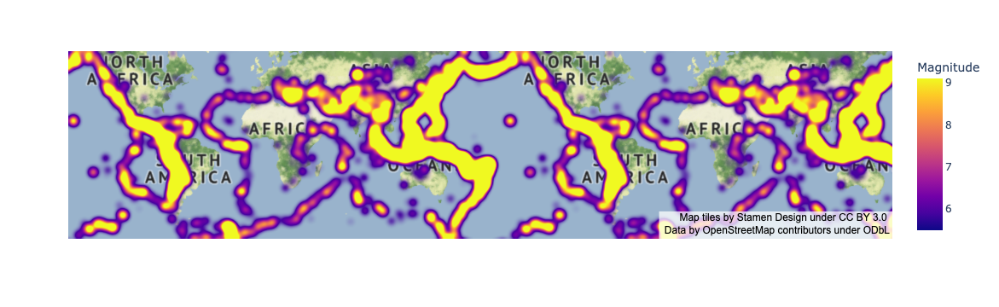

In [44]:
# density mapbox

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/earthquakes-23k.csv')

fig = px.density_mapbox(df, lat='Latitude', lon='Longitude', z='Magnitude', radius=10,
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="stamen-terrain")
fig.show()

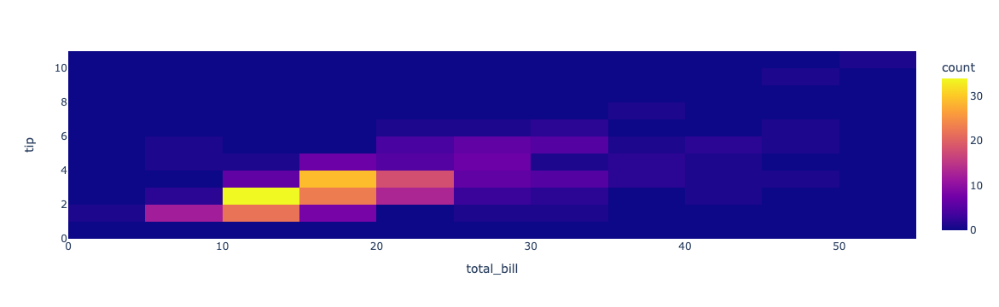

In [45]:
# density heatmap

df = px.data.tips()

fig = px.density_heatmap(df, x="total_bill", y="tip")
fig.show()

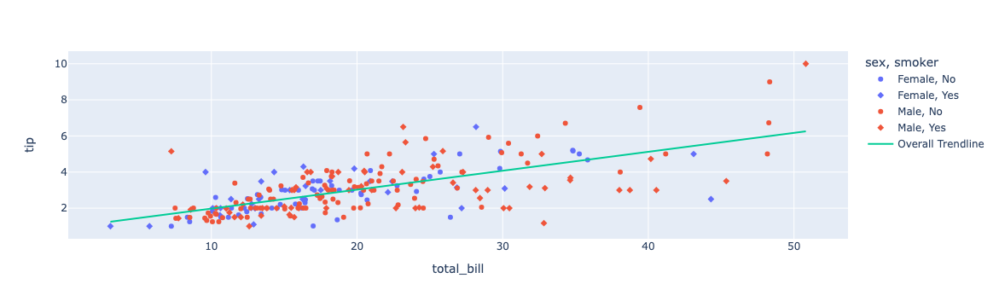

In [50]:
# trendline

df = px.data.tips()
fig = px.scatter(df, x="total_bill", y="tip", symbol="smoker", color="sex", trendline="ols", trendline_scope="overall")
fig.show()